# Data Story: What does philosophers say?
---
author: Han Wang
date: 1/30/2023

In [4]:
# import packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time
import nltk

In [5]:
# read csv
df = pd.read_csv('/Users/wanghan/Documents/ads-spring2023-project1-wangyeye66/data/philosophy_data.csv')
df.head()

,title,author,school,sentence_spacy,sentence_str,original_publication_date,corpus_edition_date,sentence_length,sentence_lowered,tokenized_txt,lemmatized_str
0,Plato - Complete Works,Plato,plato,"What's new, Socrates, to make you leave your ...","What's new, Socrates, to make you leave your ...",-350,1997,125,"what's new, socrates, to make you leave your ...","['what', 'new', 'socrates', 'to', 'make', 'you...","what be new , Socrates , to make -PRON- lea..."
1,Plato - Complete Works,Plato,plato,Surely you are not prosecuting anyone before t...,Surely you are not prosecuting anyone before t...,-350,1997,69,surely you are not prosecuting anyone before t...,"['surely', 'you', 'are', 'not', 'prosecuting',...",surely -PRON- be not prosecute anyone before ...
2,Plato - Complete Works,Plato,plato,The Athenians do not call this a prosecution b...,The Athenians do not call this a prosecution b...,-350,1997,74,the athenians do not call this a prosecution b...,"['the', 'athenians', 'do', 'not', 'call', 'thi...",the Athenians do not call this a prosecution ...
3,Plato - Complete Works,Plato,plato,What is this you say?,What is this you say?,-350,1997,21,what is this you say?,"['what', 'is', 'this', 'you', 'say']",what be this -PRON- say ?
4,Plato - Complete Works,Plato,plato,"Someone must have indicted you, for you are no...","Someone must have indicted you, for you are no...",-350,1997,101,"someone must have indicted you, for you are no...","['someone', 'must', 'have', 'indicted', 'you',...","someone must have indict -PRON- , for -PRON- ..."


To explore the data, we pick three most important features: title, author and school.
By plotting the distribution, we clearly found that Aristotle, Plato and Hegel are the top three authors in our dataset. That makes sense, since they are so well-known.
When it comes to the schools, the top three schools are analytic, aristotle, and german idealism in our dataset. 

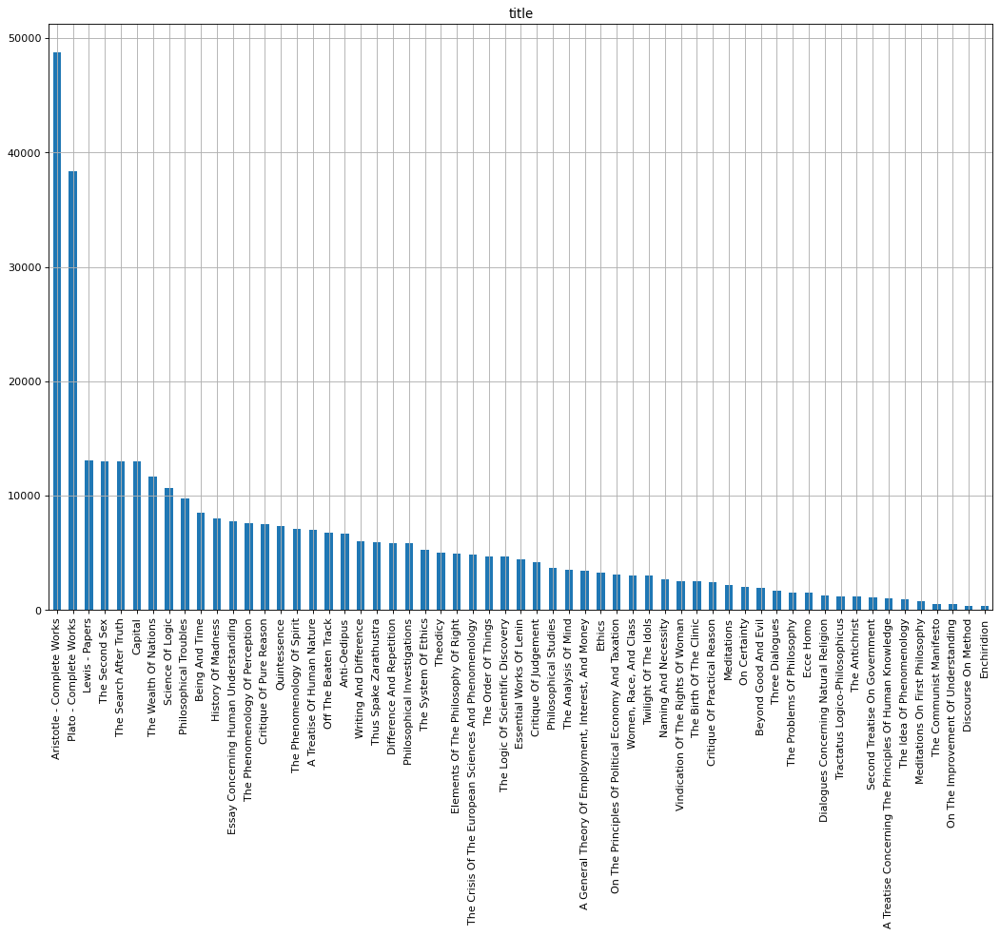

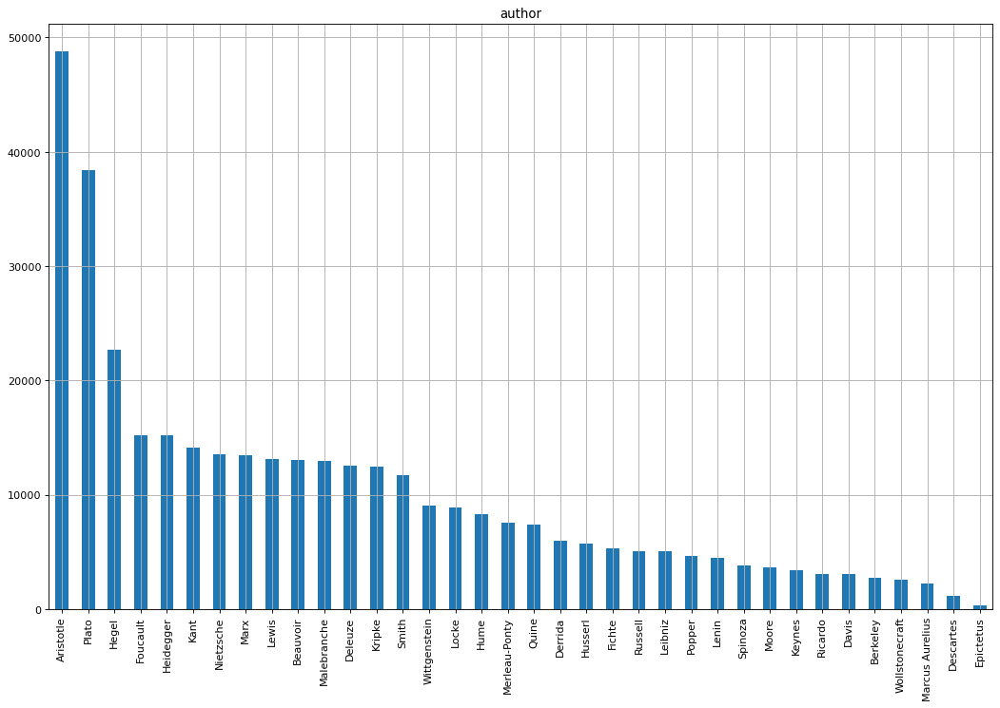

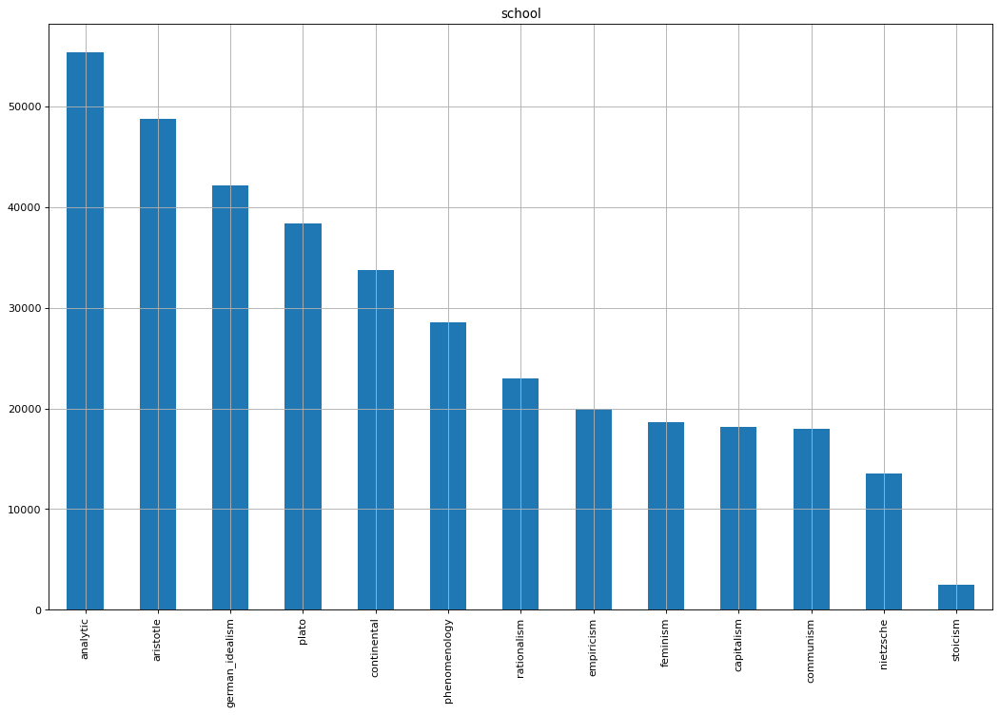

In [6]:
# categorical data distributions
features = ['title', 'author', 'school']
for f in features:
    plt.figure(figsize=(16,10), dpi = 80)
    df[f].value_counts().plot(kind = 'bar')
    plt.title(f)
    plt.grid()
    plt.show()

Now, lets focus on numerical data. Sentence length is an important feature in this dataset. The median sentence length in this data set is 127 words. The longest sentense is 2649 words! I seems philosphers love to say long sentences. 
It is also interesting to find that the sentence length is about distributed normally with log-scale. The result is what I expected.

count    360808.000000
mean        150.790964
std         104.822072
min          20.000000
25%          75.000000
50%         127.000000
75%         199.000000
max        2649.000000
Name: sentence_length, dtype: float64


Text(-12.805555555555555, 0.5, 'Counts')

<Figure size 1200x500 with 0 Axes>

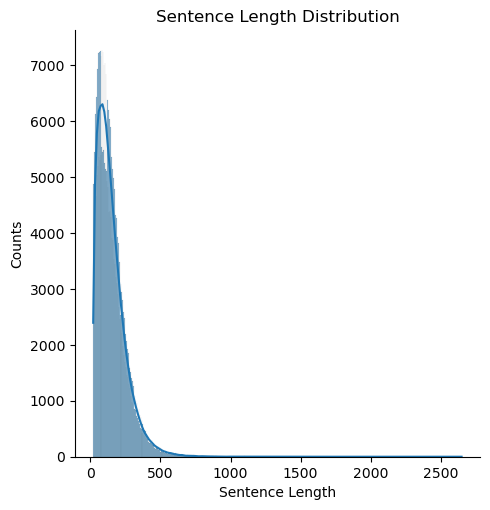

<Figure size 1200x500 with 0 Axes>

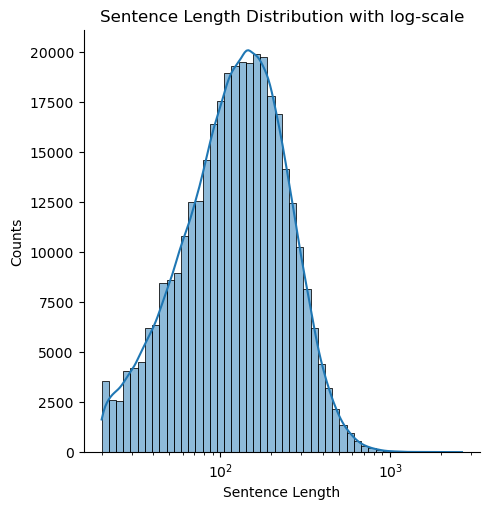

In [7]:
# show distributions of numerical data before moving forward
print(df.sentence_length.describe())
plt.figure(figsize=(12,5))
sns.displot(df['sentence_length'], kde =True)
plt.title('Sentence Length Distribution')
plt.xlabel('Sentence Length')
plt.ylabel('Counts')
# plt.savefig('sentence_length_dist.png', format='png', dpi=80, bbox_inches='tight')


# looks like a normal distribution
plt.figure(figsize=(12,5))
sns.displot(df['sentence_length'],log_scale = True, kde= True, bins=50)
plt.title('Sentence Length Distribution with log-scale')
plt.xlabel('Sentence Length')
plt.ylabel('Counts')
# plt.savefig('sentence_length_dist_log.png', format='png', dpi=80, bbox_inches='tight')



The distribution of corpus edition date is cluster at year 1990 to 2010.

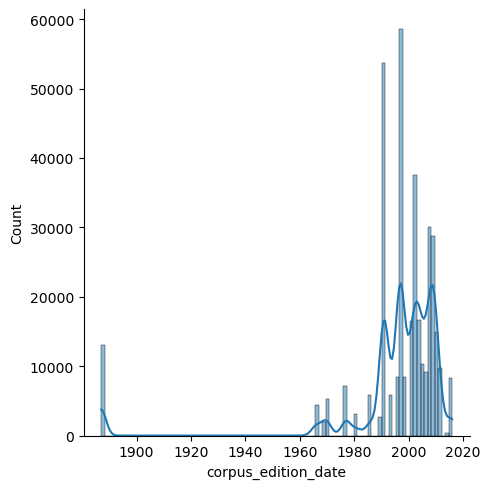

In [8]:
# corpus edition date cluster around year 1990~2010
sns.displot(df['corpus_edition_date'],kde = True, bins = 100)

## Who is the most verbose Author?

To answer this, I averaged up the sentence length for each author and displayed in a horizontal bar plot. Then, rank the averaged value from the highest to lowest. It is clearly shown on the figure that, Descartes is the most verbose Author among all philosophers in our dataset. 

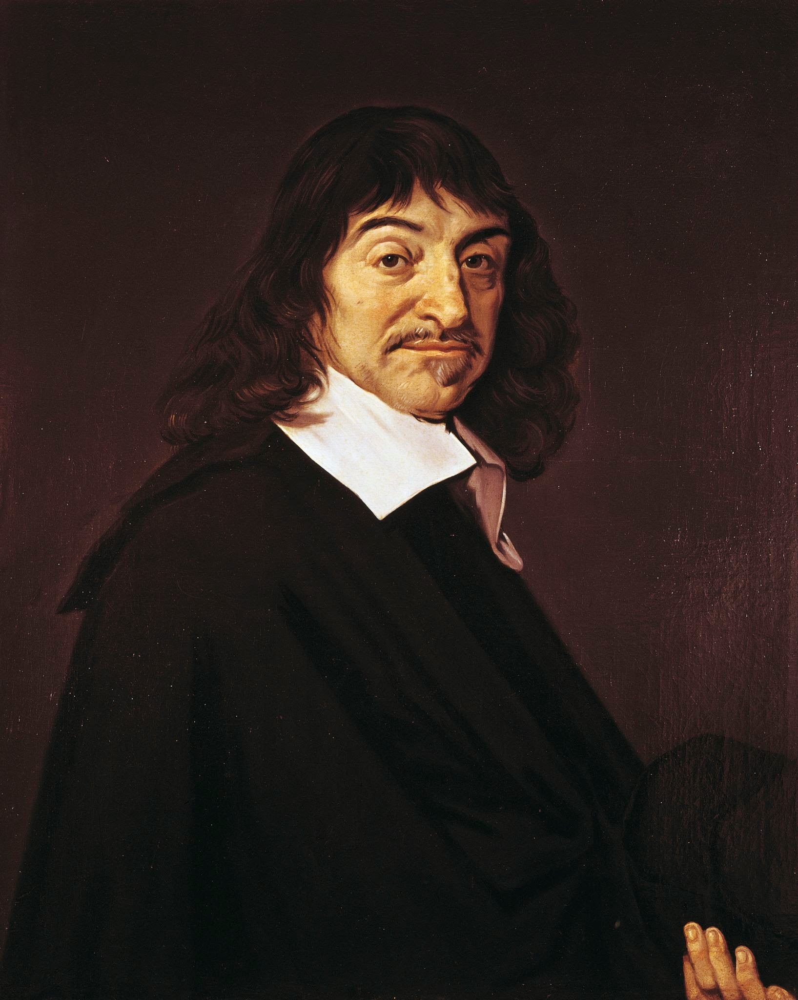


Text(0.5, 0, 'Length')

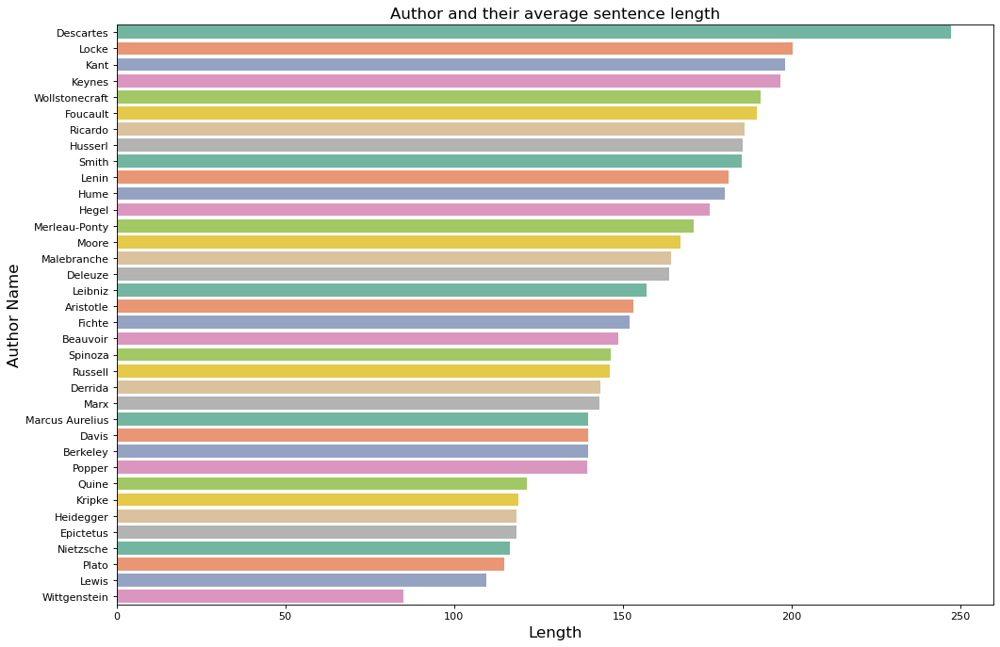

In [9]:
# sentence length comparison over authors
avg_len = df['sentence_length'].groupby(df['author']).mean()
avg_len_df = pd.DataFrame({'author': avg_len.index, 'length':avg_len.values})
avg_len_df = avg_len_df.sort_values(by = ['length'], ascending = False)
avg_len_df

plt.figure(figsize=(15,10), dpi = 80)
ax = sns.barplot(x = 'length',
                 y = 'author', 
                 palette = 'Set2',
                 data = avg_len_df)
ax.set_title('Author and their average sentence length', fontsize=15)
ax.set_ylabel('Author Name', fontsize=15)
ax.set_xlabel('Length', fontsize=15)


Then, I plot a figure showing the sentence length comparison on different schools. However, there is no correlation between the sentence length and different type of schools.

Text(0, 0.5, 'Schools')

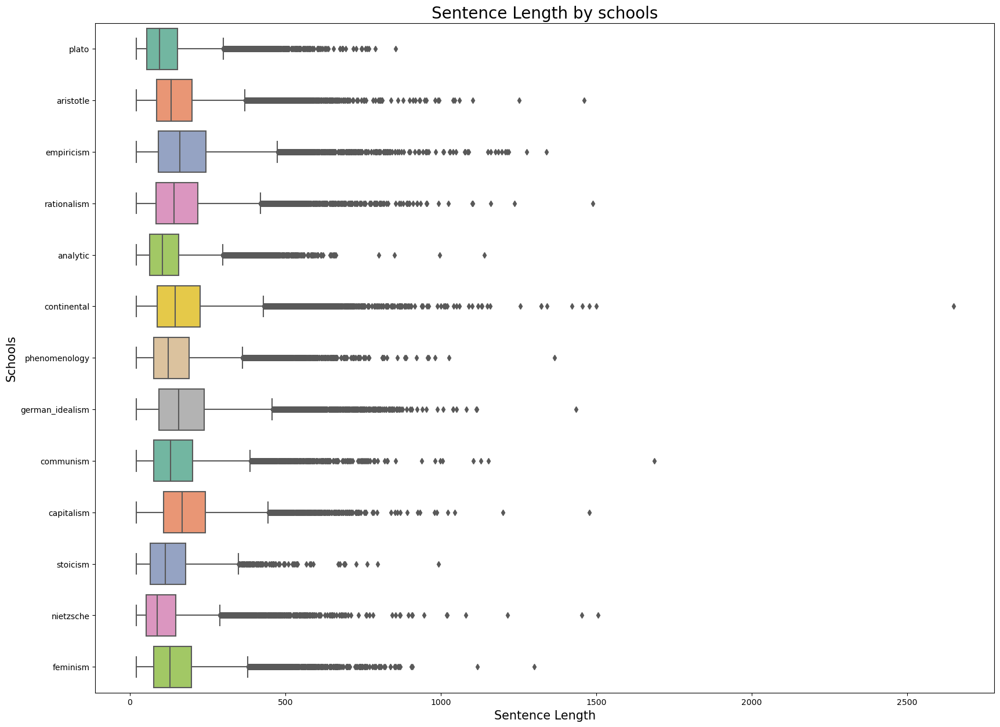

In [10]:
# sentence length by schools
plt.figure(figsize=(20,15))
sns.boxplot(y ='school', 
            x = 'sentence_length',
            palette = 'Set2', 
            data = df)
plt.title('Sentence Length by schools', fontsize = 20)
plt.xlabel('Sentence Length',fontsize=15)
plt.ylabel('Schools',fontsize=15)



The following figures are wordclouds for each school. For example, the school of Plato, the most frquent words are: one, thing, will, god,soul...... We can compare the wordclouds from different schools.

School =  PLATO :


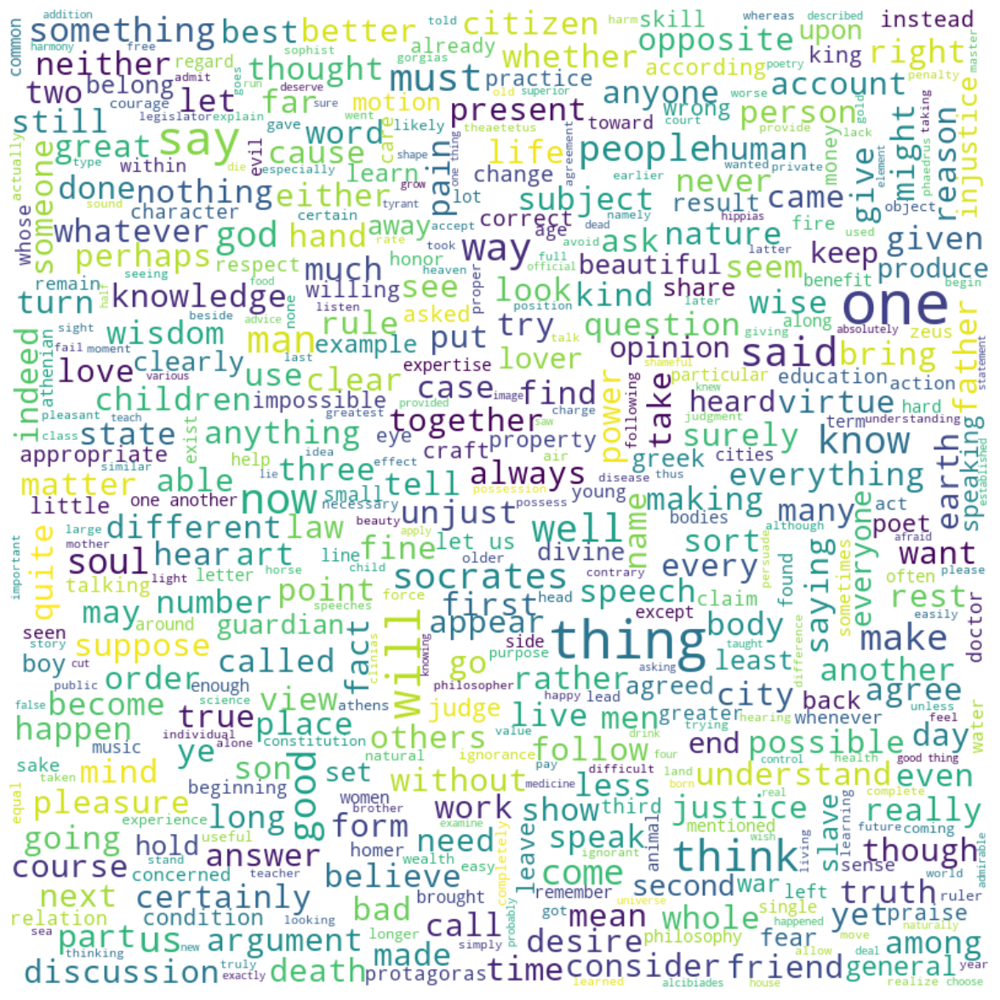

School =  ARISTOTLE :


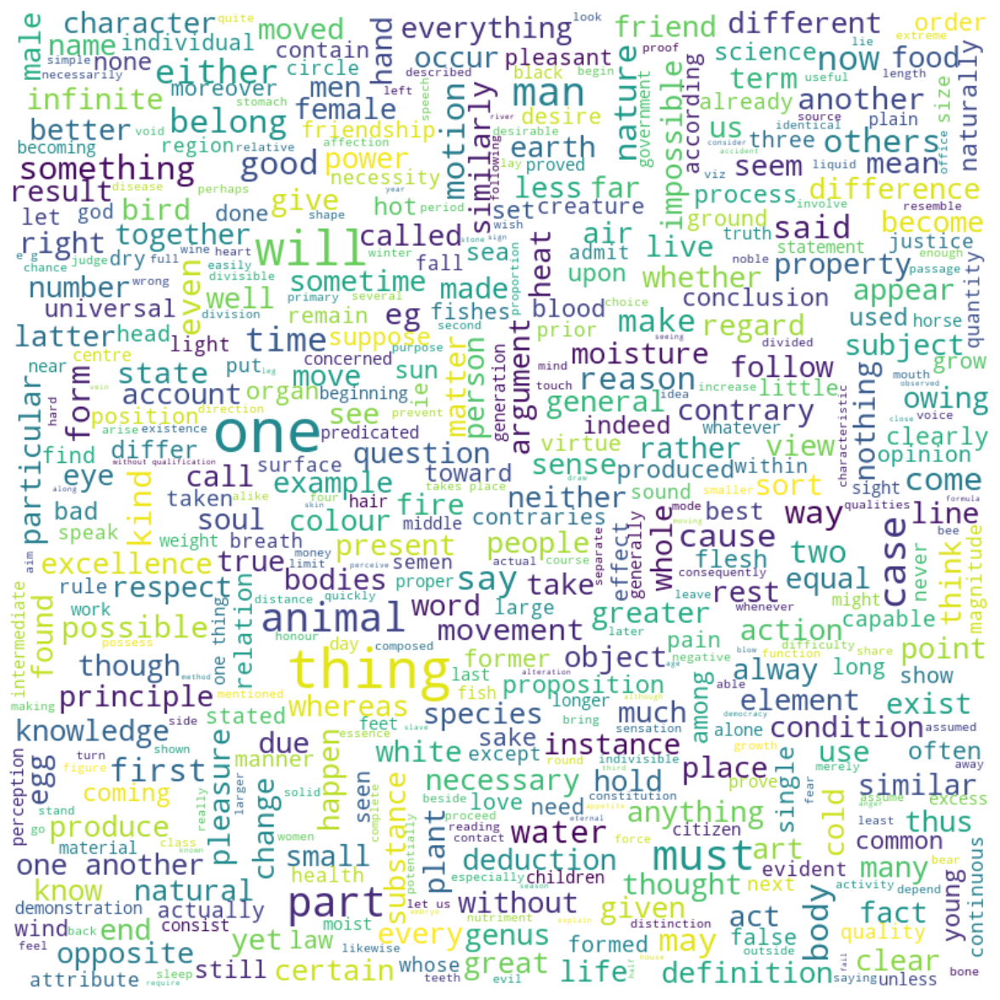

School =  EMPIRICISM :


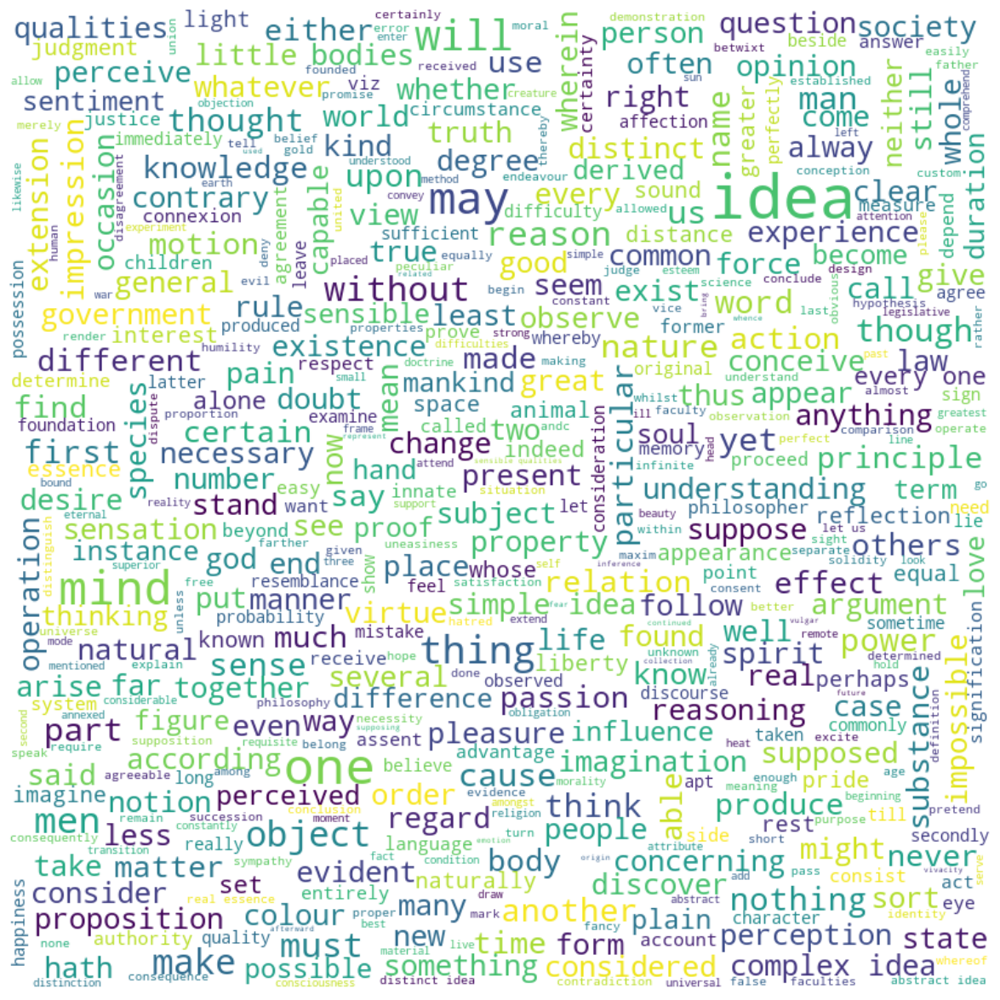

School =  RATIONALISM :


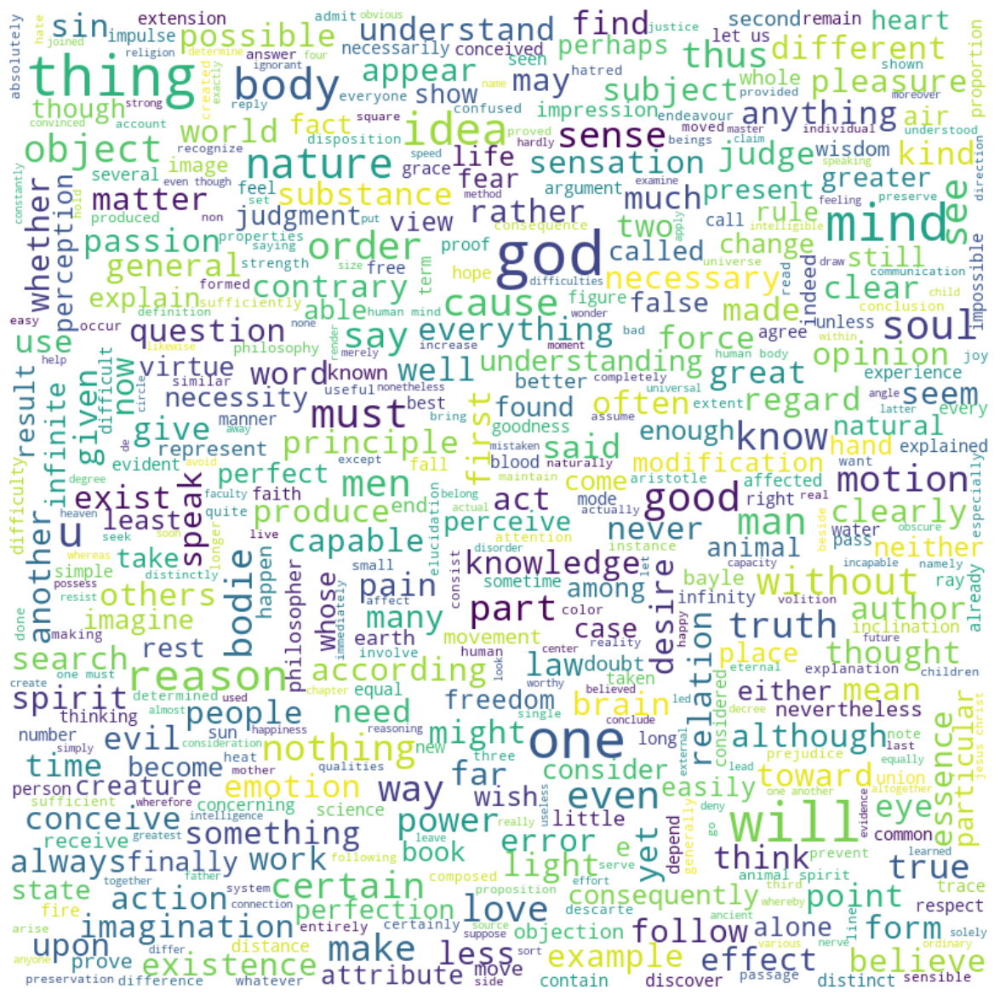

School =  ANALYTIC :


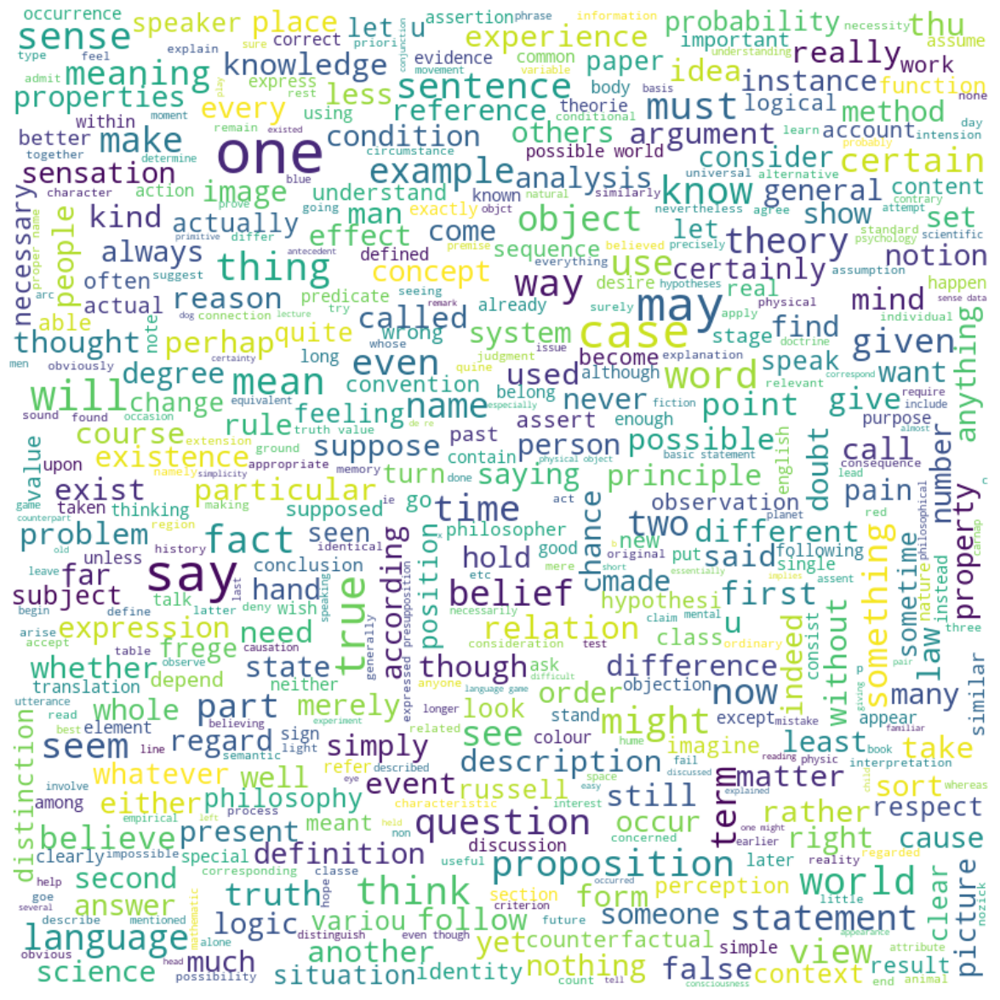

School =  CONTINENTAL :


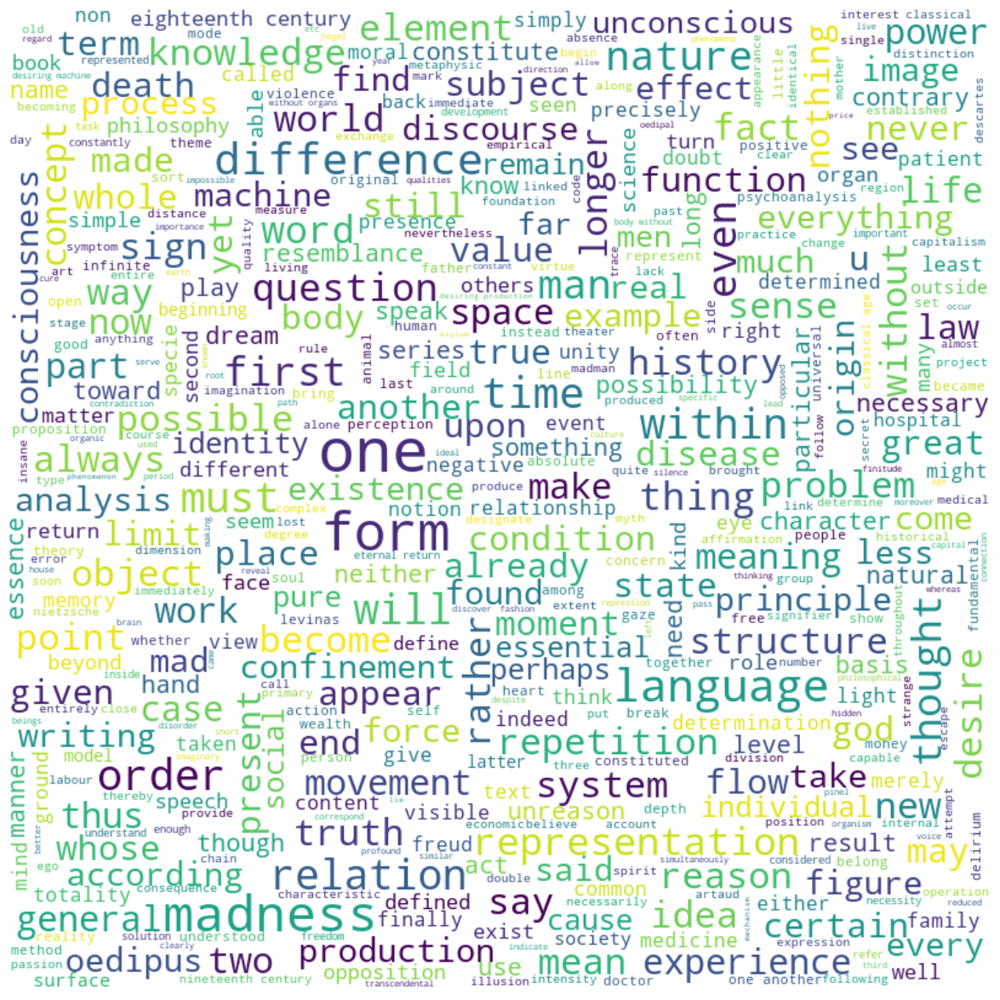

School =  PHENOMENOLOGY :


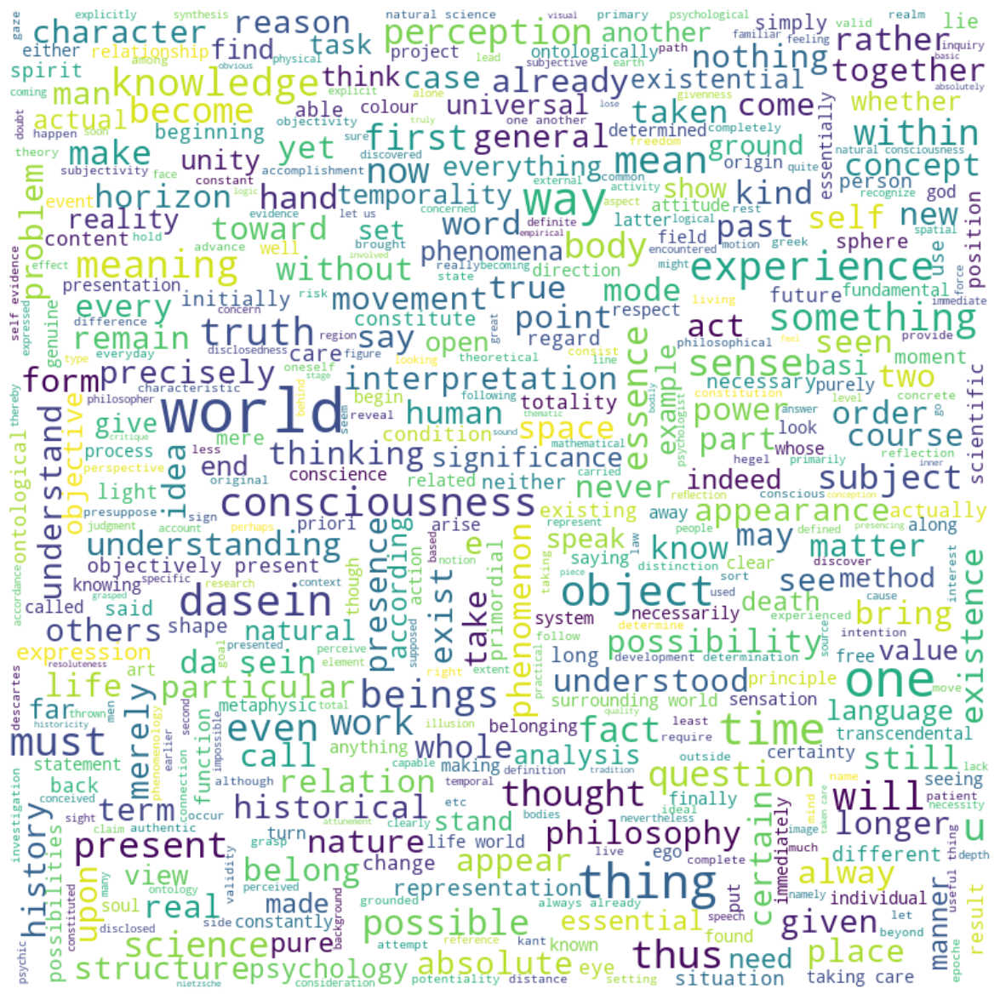

School =  GERMAN_IDEALISM :


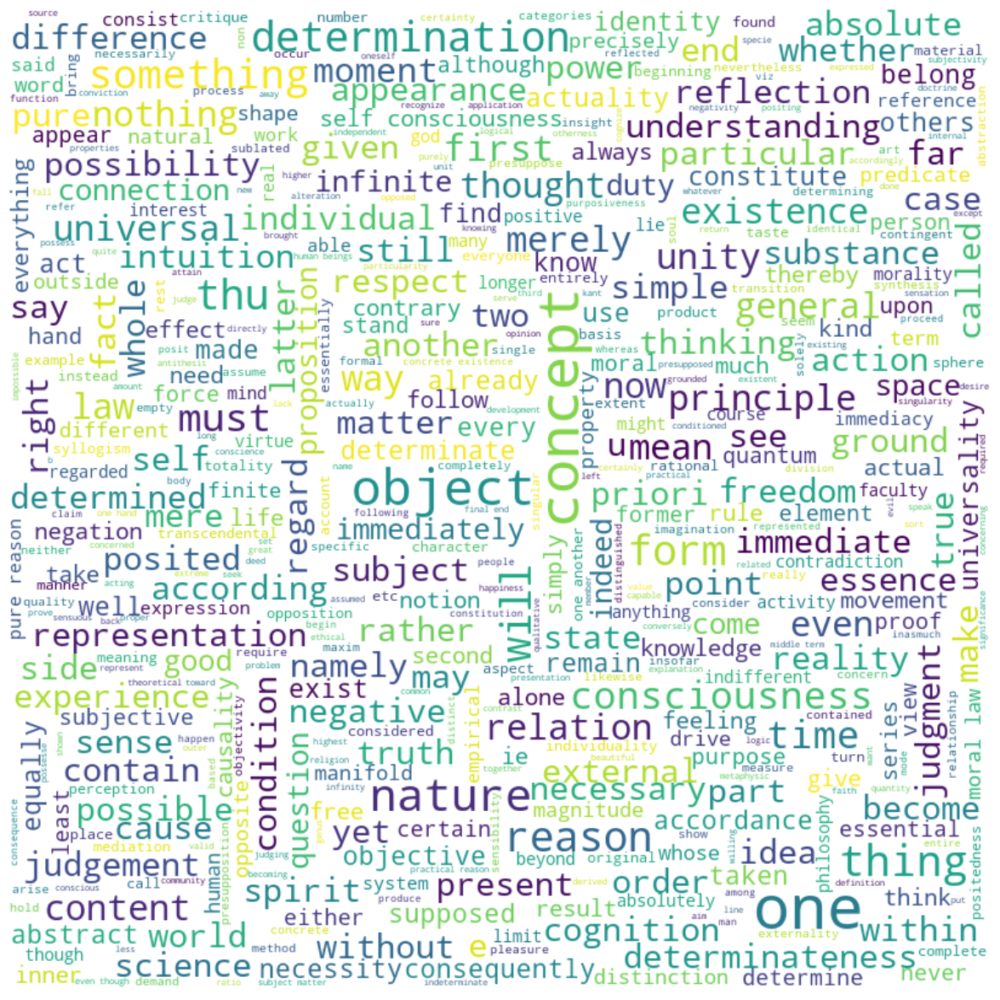

School =  COMMUNISM :


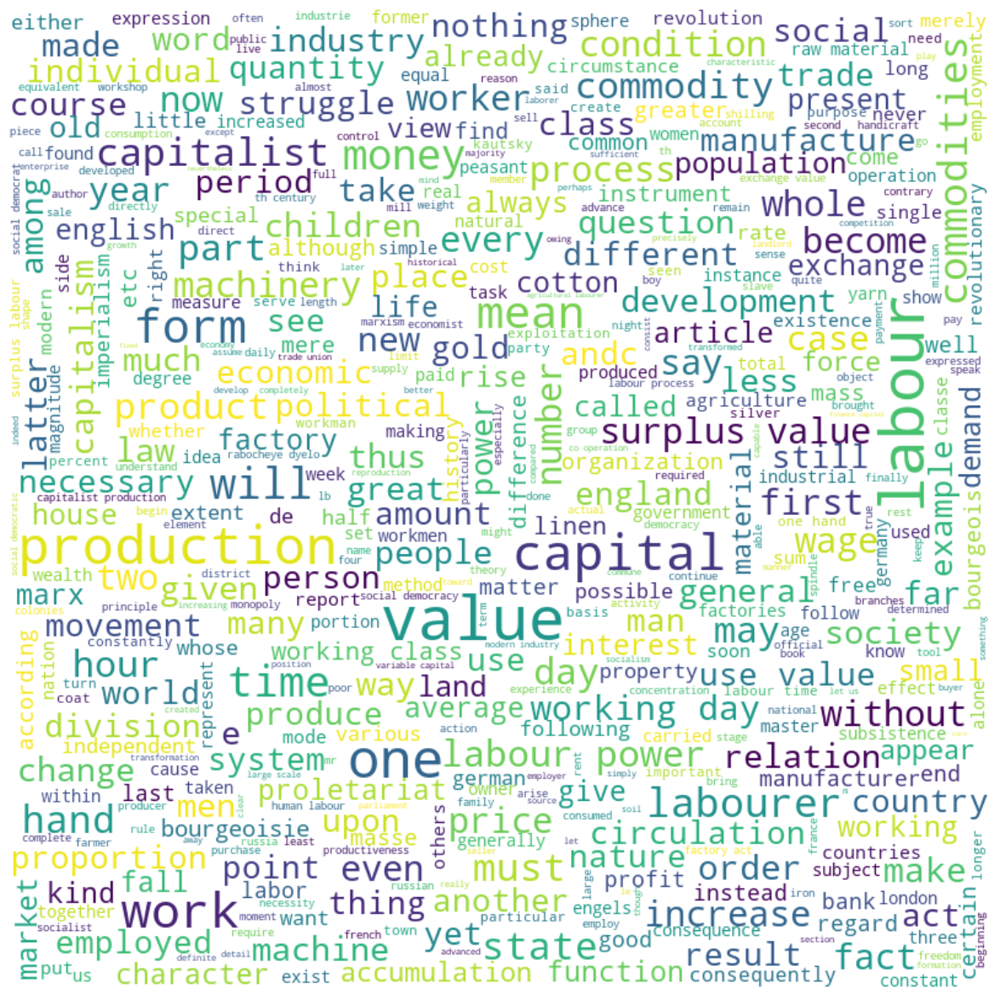

School =  CAPITALISM :


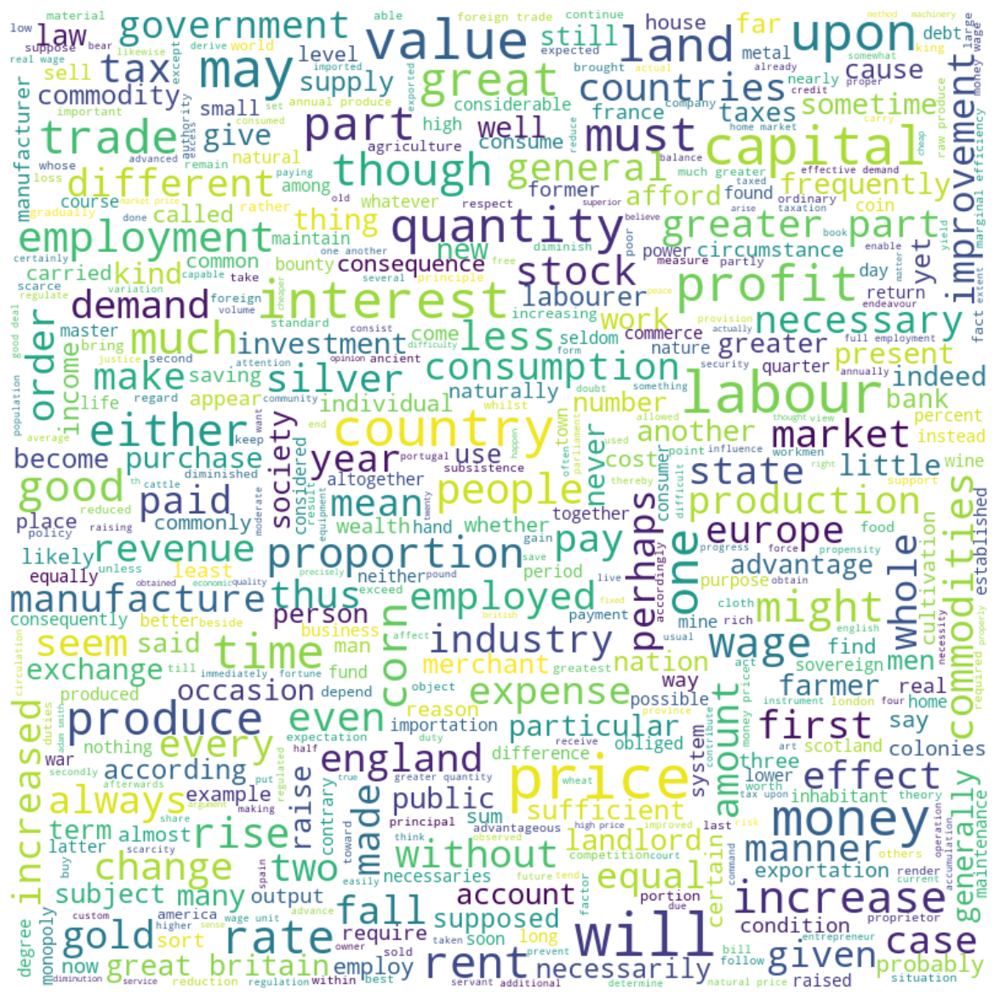

School =  STOICISM :


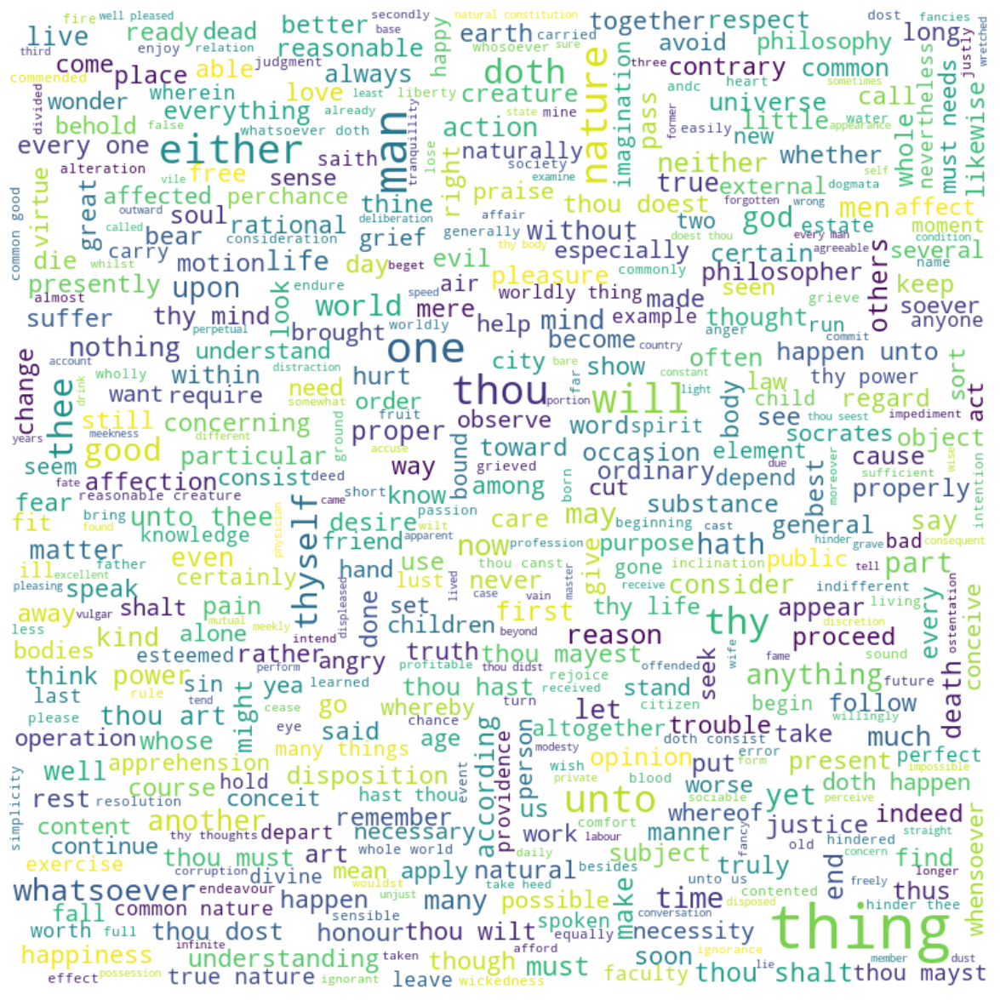

School =  NIETZSCHE :


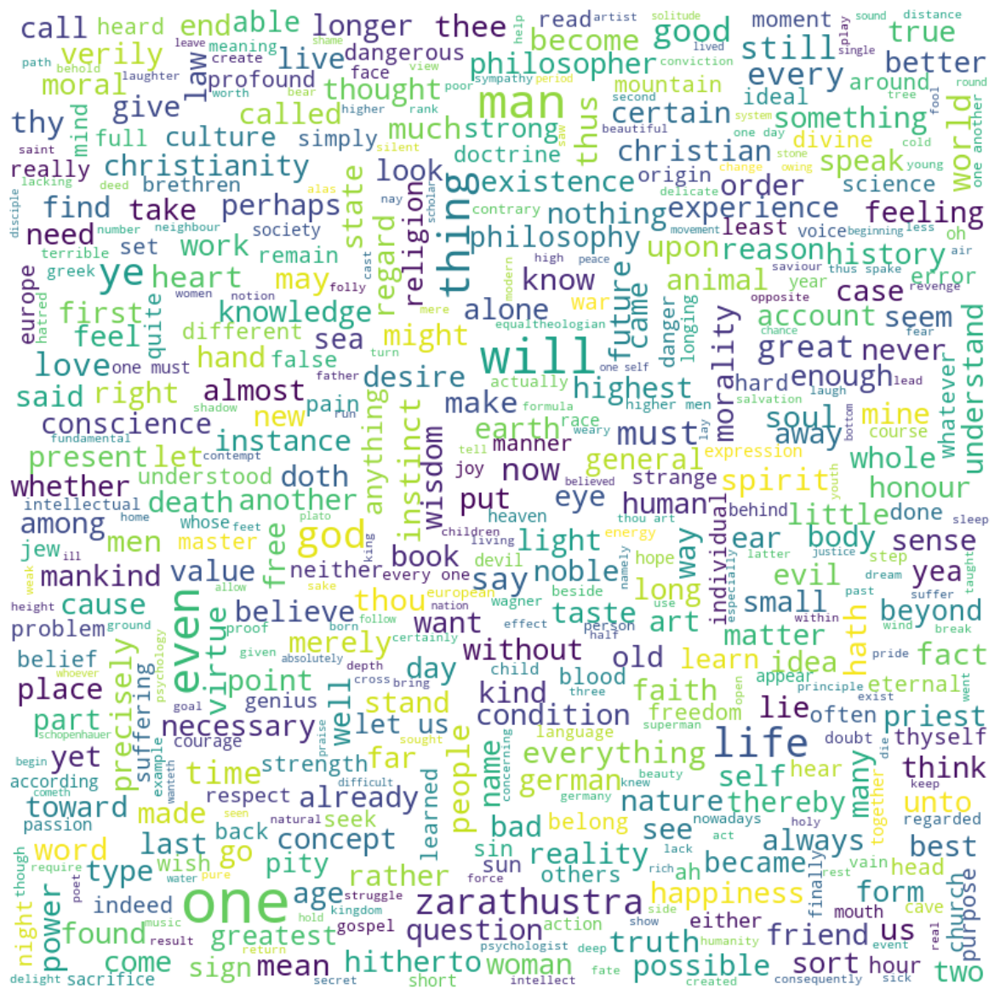

School =  FEMINISM :


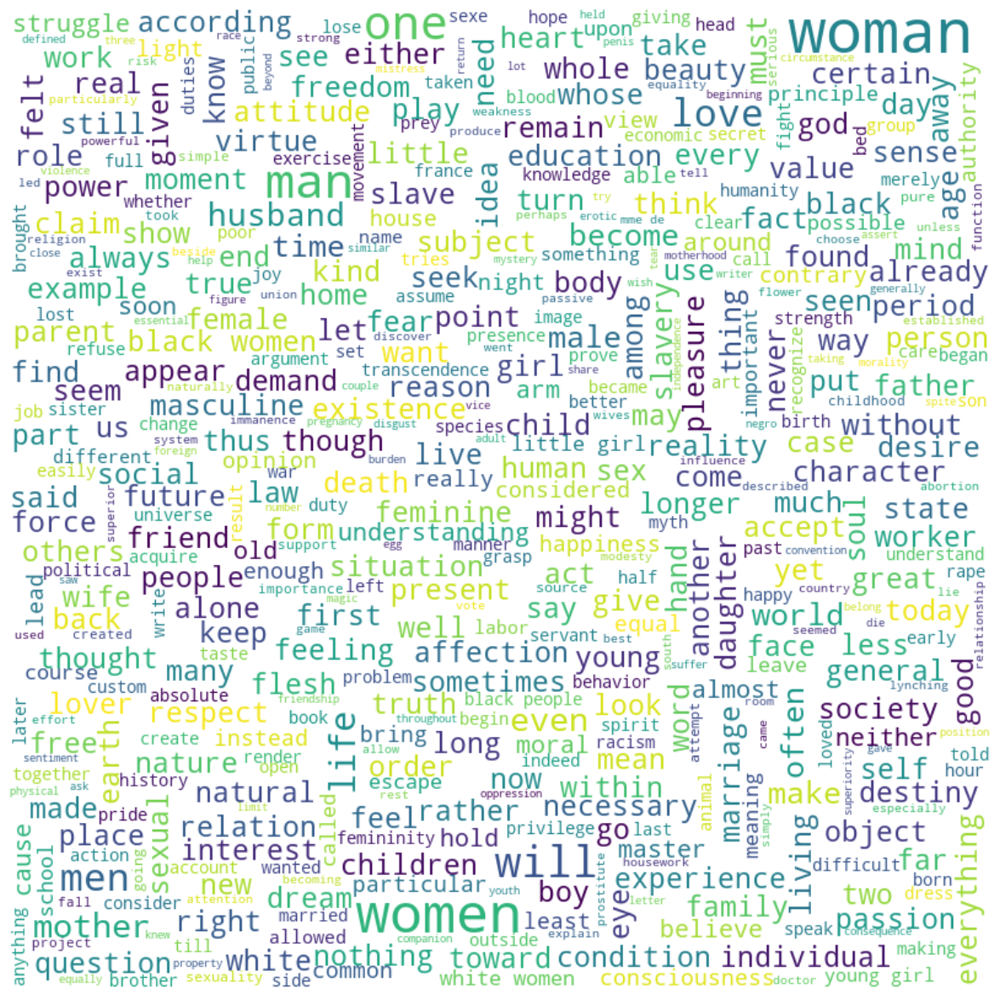

Elapsed time:  37.39


In [11]:
from wordcloud import WordCloud, STOPWORDS

schools = df.school.unique()

# create a wordcloud for each school
t1 = time.time()
for i in schools:
    df_temp = df[df.school == i]
    print('School = ', i.upper(), ':')
    
    text = " ".join(txt for txt in df_temp.sentence_lowered)
    wordcloud = WordCloud(width = 800, height = 800, 
                          max_font_size = 50,
                          max_words= 500,
                          background_color='white',
                          stopwords = STOPWORDS).generate(text)
    plt.figure(figsize=(15,15))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
t2 = time.time()
print('Elapsed time: ', np.round(t2-t1, 2))


Finally, I vectorized the each word in sentences using H2OWord2vecEstimator. After training the model, We can put in a word and try to let the model to select the synonyms. The 'find_synonyms' method will tell you the word select and the how that word correlated to the input word.

In [12]:
# to build a model that finding synonyms based on what philosophers said
import h2o
from h2o.estimators import H2OWord2vecEstimator, H2OGradientBoostingEstimator

h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 . connected.


H2O_cluster_uptime:,2 days 7 hours 43 mins
H2O_cluster_timezone:,America/New_York
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.38.0.4
H2O_cluster_version_age:,26 days
H2O_cluster_name:,H2O_from_python_wanghan_662vpz
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,2.460 Gb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


In [13]:
# create a dataframe
text_h2o = h2o.H2OFrame(df[['school', 'sentence_lowered']])

def tokenize(sentences, stop_word = STOPWORDS): 
    tokenized = sentences.tokenize("\\W+")
    tokenized_lower = tokenized.tolower()
    tokenized_filtered = tokenized_lower[(tokenized_lower.nchar() >= 2) | (tokenized_lower.isna()),:]
    tokenized_words = tokenized_filtered[tokenized_filtered.grep("[0-9]",invert=True,output_logical=True),:]
    tokenized_words = tokenized_words[(tokenized_words.isna()) | (~ tokenized_words.isin(stop_word)),:]
    return tokenized_words

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [14]:
words = tokenize(text_h2o['sentence_lowered'])

In [15]:
import random
random.seed(2023)

t1 = time.time()
# transform word to a matrix of vectors
w2v_model = H2OWord2vecEstimator(vec_size = 50,
                                 window_size = 5,
                                 sent_sample_rate = 0.001,
                                 init_learning_rate = 0.025,
                                 epochs = 10)
w2v_model.train(training_frame=words)
t2 = time.time()
print('Elapsed time:', np.round(t2-t1,2), 'secs')

word2vec Model Build progress: |█████████████████████████████████████████████████| (done) 100%
Elapsed time: 104.55 secs


In [16]:
# find synonyms of word 'time'
w2v_model.find_synonyms('time', count =5)

OrderedDict([('now', 0.7298144102096558),
             ('first', 0.7253277897834778),
             ('thus', 0.7246754169464111),
             ('always', 0.7177305221557617),
             ('never', 0.7050063014030457)])

In [17]:
w2v_model.find_synonyms('food', count =5)

OrderedDict([('nourishment', 0.7878297567367554),
             ('drink', 0.7783762216567993),
             ('feeding', 0.7734711766242981),
             ('fodder', 0.760887622833252),
             ('foods', 0.7538816332817078)])